In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import scanpy as sc
from scib_metrics.benchmark import Benchmarker
import time
from pathlib import Path
import torch
import Concord as ccd
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [3]:
proj_name = "concord_treg"
save_dir = f"./save/dev_{proj_name}-{time.strftime('%b%d')}/"
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
seed = 0
ccd.ul.set_seed(seed)


In [4]:
data_path = "data/treg_data/R_treg_graph_ad.h5ad"
adata = sc.read(
    data_path
)
adata.obs['T_subtype_refined']=adata.obs['T_subtype_refined'].cat.remove_unused_categories()


In [5]:
feature_list = ccd.ul.select_features(adata, n_top_features=3000, flavor='seurat_v3')


Concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...


In [6]:
params = {
    "project_name": proj_name,
    "input_feature": feature_list,
    "batch_size": 64,
    "n_epochs": 5,
    "lr": 1e-3,
    "latent_dim": 32,
    "encoder_dims": [256],
    "decoder_dims": [256],
    "augmentation_mask_prob": 0.5,
    "dropout_prob": 0.1,
    "use_decoder": True,
    "decoder_weight": 1.0,
    "use_classifier": False,
    "classifier_weight": 1.0,
    "use_clr_aug": True,
    "use_clr_knn": False,
    "clr_aug_temperature":0.5,
    "domain_embedding_dim":8,
    "use_importance_mask": True,
    "importance_penalty_type": 'L1',
    "importance_penalty_weight": 0,
    "domain_key": 'dataset.ident',
    "class_key": None,
    "sampler_emb": "X_pca",
    "sampler_knn": 128,
    "p_intra_knn": 0.5,
    "p_intra_domain": None,
    "min_p_intra_domain": 0.9,
    "pca_n_comps": 50,
    "use_faiss": True,
    "use_ivf": True,
    "ivf_nprobe": 10,
    "inplace": False,
    "save_dir": save_dir,
    "device": device,
    "verbose": True
}
output_key = "Concord"
file_suffix = f"{time.strftime('%b%d-%H%M')}"

In [7]:
# Single run
cur_ccd = ccd.Concord(adata=adata, **params)
cur_ccd.encode_adata(input_layer_key="X_log1p", output_key=output_key)
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, obsm_filename)
adata.obsm[output_key] = cur_ccd.adata.obsm[output_key] # If not inplace

Concord - INFO - Column 'dataset.ident' is already of type: category
Concord - INFO - Unused levels dropped for column 'dataset.ident'.
Concord - INFO - Encoder input dim: 3000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Total number of parameters: 1562096
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'idx']
Concord.model.dataloader - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord.model.dataloader - INFO - PCA completed.
Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.knn - INFO - Building Faiss IVF index. nprobe=10
Concord.model.knn - INFO - Using FAISS CPU index.
Concord.model.dataloader - INFO - Number

Epoch 0 Training: 461it [00:21, 21.45it/s, loss=4.19]

Concord - INFO - Epoch   0 | Train Loss: 4.41, MSE: 0.17, CLASS: 0.00, CLR_AUG: 4.24, CLR_KNN: 0.00, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 2/5
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 29584



Epoch 1 Training: 100%|██████████| 461/461 [00:26<00:00, 17.14it/s, loss=3.88]

Concord - INFO - Epoch   1 | Train Loss: 4.05, MSE: 0.13, CLASS: 0.00, CLR_AUG: 3.92, CLR_KNN: 0.00, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 3/5
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 29584



Epoch 2 Training: 100%|██████████| 461/461 [00:24<00:00, 19.03it/s, loss=3.99]

Concord - INFO - Epoch   2 | Train Loss: 3.97, MSE: 0.12, CLASS: 0.00, CLR_AUG: 3.85, CLR_KNN: 0.00, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 4/5
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 29584



Epoch 3 Training: 100%|██████████| 461/461 [00:23<00:00, 19.54it/s, loss=4.05]

Concord - INFO - Epoch   3 | Train Loss: 3.94, MSE: 0.12, CLASS: 0.00, CLR_AUG: 3.81, CLR_KNN: 0.00, IMPORTANCE: 0.00
Concord - INFO - Starting epoch 5/5
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 29584



Epoch 4 Training: 100%|██████████| 461/461 [00:26<00:00, 17.23it/s, loss=3.97]

Concord - INFO - Epoch   4 | Train Loss: 3.91, MSE: 0.12, CLASS: 0.00, CLR_AUG: 3.79, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Model saved to save/dev_concord_treg-Sep02/final_model.pth
Concord - INFO - Final model saved at: save/dev_concord_treg-Sep02/final_model.pth; Configuration saved at: save/dev_concord_treg-Sep02/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'idx']
Concord - INFO - Predicting for chunk 1/1


Concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


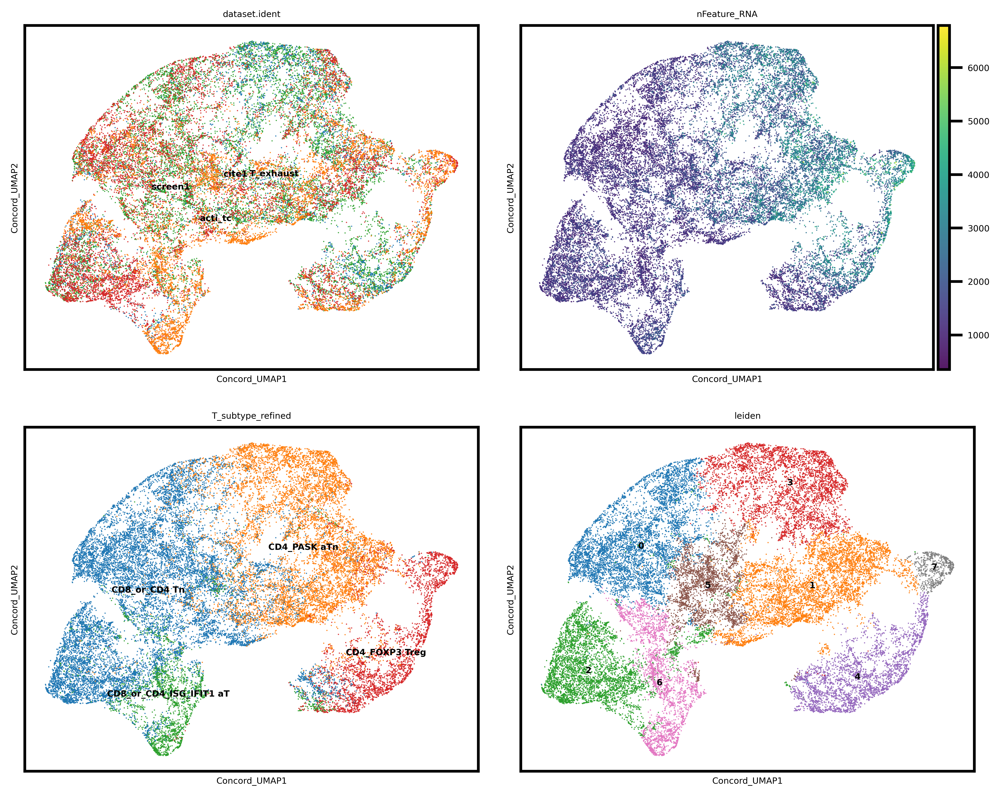

In [8]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)
sc.pp.neighbors(adata, use_rep="Concord")
sc.tl.leiden(adata, resolution=0.2)
show_cols = ['dataset.ident', 'nFeature_RNA', 'T_subtype_refined', 'leiden']
show_emb = 'Concord_UMAP'

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,8), dpi=600, ncols=2, font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)


In [18]:
import torch
from torch import nn
from torch.nn import functional as F

In [19]:
z_1 = torch.randn(4, 2)
z_2 = z_1
x = torch.cat((z_1, z_2), dim=0)
xcs = F.cosine_similarity(x[None,:,:], x[:,None,:], dim=-1)
xcs

tensor([[ 1.0000,  0.9699, -0.0451,  0.9979,  1.0000,  0.9699, -0.0451,  0.9979],
        [ 0.9699,  1.0000,  0.1996,  0.9835,  0.9699,  1.0000,  0.1996,  0.9835],
        [-0.0451,  0.1996,  1.0000,  0.0191, -0.0451,  0.1996,  1.0000,  0.0191],
        [ 0.9979,  0.9835,  0.0191,  1.0000,  0.9979,  0.9835,  0.0191,  1.0000],
        [ 1.0000,  0.9699, -0.0451,  0.9979,  1.0000,  0.9699, -0.0451,  0.9979],
        [ 0.9699,  1.0000,  0.1996,  0.9835,  0.9699,  1.0000,  0.1996,  0.9835],
        [-0.0451,  0.1996,  1.0000,  0.0191, -0.0451,  0.1996,  1.0000,  0.0191],
        [ 0.9979,  0.9835,  0.0191,  1.0000,  0.9979,  0.9835,  0.0191,  1.0000]])

In [20]:
y = xcs.clone()
eye = torch.eye(8)
y[eye.bool()] = float("inf")
y, y.sigmoid()

(tensor([[    inf,  0.9699, -0.0451,  0.9979,  1.0000,  0.9699, -0.0451,  0.9979],
         [ 0.9699,     inf,  0.1996,  0.9835,  0.9699,  1.0000,  0.1996,  0.9835],
         [-0.0451,  0.1996,     inf,  0.0191, -0.0451,  0.1996,  1.0000,  0.0191],
         [ 0.9979,  0.9835,  0.0191,     inf,  0.9979,  0.9835,  0.0191,  1.0000],
         [ 1.0000,  0.9699, -0.0451,  0.9979,     inf,  0.9699, -0.0451,  0.9979],
         [ 0.9699,  1.0000,  0.1996,  0.9835,  0.9699,     inf,  0.1996,  0.9835],
         [-0.0451,  0.1996,  1.0000,  0.0191, -0.0451,  0.1996,     inf,  0.0191],
         [ 0.9979,  0.9835,  0.0191,  1.0000,  0.9979,  0.9835,  0.0191,     inf]]),
 tensor([[1.0000, 0.7251, 0.4887, 0.7307, 0.7311, 0.7251, 0.4887, 0.7307],
         [0.7251, 1.0000, 0.5497, 0.7278, 0.7251, 0.7311, 0.5497, 0.7278],
         [0.4887, 0.5497, 1.0000, 0.5048, 0.4887, 0.5497, 0.7311, 0.5048],
         [0.7307, 0.7278, 0.5048, 1.0000, 0.7307, 0.7278, 0.5048, 0.7311],
         [0.7311, 0.7251, 0.4887, 

In [21]:
temperature = 0.5
(y / temperature).sigmoid()

tensor([[1.0000, 0.8743, 0.4775, 0.8804, 0.8808, 0.8743, 0.4775, 0.8804],
        [0.8743, 1.0000, 0.5985, 0.8773, 0.8743, 0.8808, 0.5985, 0.8773],
        [0.4775, 0.5985, 1.0000, 0.5095, 0.4775, 0.5985, 0.8808, 0.5095],
        [0.8804, 0.8773, 0.5095, 1.0000, 0.8804, 0.8773, 0.5095, 0.8808],
        [0.8808, 0.8743, 0.4775, 0.8804, 1.0000, 0.8743, 0.4775, 0.8804],
        [0.8743, 0.8808, 0.5985, 0.8773, 0.8743, 1.0000, 0.5985, 0.8773],
        [0.4775, 0.5985, 0.8808, 0.5095, 0.4775, 0.5985, 1.0000, 0.5095],
        [0.8804, 0.8773, 0.5095, 0.8808, 0.8804, 0.8773, 0.5095, 1.0000]])

In [22]:
batch_size=4
t1 = torch.cat([torch.arange(batch_size) + batch_size, torch.arange(batch_size)], dim=0)
labels = torch.cat([torch.arange(batch_size) for _ in range(2)], dim=0)
labels = (labels.unsqueeze(0) == labels.unsqueeze(1)).float()
#labels = labels.masked_fill(mask, 0)
labels


tensor([[1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 0., 1.],
        [1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 0., 1.]])

In [23]:
xcs = F.cosine_similarity(x[None,:,:], x[:,None,:], dim=-1)
xcs[torch.eye(x.size(0)).bool()] = float("inf")
loss = F.binary_cross_entropy((xcs / temperature).sigmoid(), labels, reduction="none")
loss

tensor([[-0.0000, 2.0741, 0.6491, 2.1233, 0.1269, 2.0741, 0.6491, 2.1233],
        [2.0741, -0.0000, 0.9125, 2.0979, 2.0741, 0.1269, 0.9125, 2.0979],
        [0.6491, 0.9125, -0.0000, 0.7124, 0.6491, 0.9125, 0.1269, 0.7124],
        [2.1233, 2.0979, 0.7124, -0.0000, 2.1233, 2.0979, 0.7124, 0.1269],
        [0.1269, 2.0741, 0.6491, 2.1233, -0.0000, 2.0741, 0.6491, 2.1233],
        [2.0741, 0.1269, 0.9125, 2.0979, 2.0741, -0.0000, 0.9125, 2.0979],
        [0.6491, 0.9125, 0.1269, 0.7124, 0.6491, 0.9125, -0.0000, 0.7124],
        [2.1233, 2.0979, 0.7124, 0.1269, 2.1233, 2.0979, 0.7124, -0.0000]])

In [27]:
x.shape

torch.Size([8, 2])

In [24]:
(xcs / temperature).sigmoid().shape

torch.Size([8, 8])

In [28]:
labels

tensor([[1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 0., 1.],
        [1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 0., 1.]])

In [ ]:
temperature = 0.5
target = labels
loss = F.binary_cross_entropy((y / temperature).sigmoid(), target, reduction="none")
print(loss)
target_pos = target.bool()
target_neg = ~target_pos

print("\nPositive pairs mask")
print(target_pos)

print("\nNegative pairs mask")
print(target_neg)

tensor([[-0.0000, 1.6068, 0.8541, 1.8021, 0.1269, 1.6068, 0.8541, 1.8021],
        [1.6068, -0.0000, 1.8136, 2.0979, 1.6068, 0.1269, 1.8136, 2.0979],
        [0.8541, 1.8136, -0.0000, 1.6205, 0.8541, 1.8136, 0.1269, 1.6205],
        [1.8021, 2.0979, 1.6205, -0.0000, 1.8021, 2.0979, 1.6205, 0.1269],
        [0.1269, 1.6068, 0.8541, 1.8021, -0.0000, 1.6068, 0.8541, 1.8021],
        [1.6068, 0.1269, 1.8136, 2.0979, 1.6068, -0.0000, 1.8136, 2.0979],
        [0.8541, 1.8136, 0.1269, 1.6205, 0.8541, 1.8136, -0.0000, 1.6205],
        [1.8021, 2.0979, 1.6205, 0.1269, 1.8021, 2.0979, 1.6205, -0.0000]])

Positive pairs mask
tensor([[ True, False, False, False,  True, False, False, False],
        [False,  True, False, False, False,  True, False, False],
        [False, False,  True, False, False, False,  True, False],
        [False, False, False,  True, False, False, False,  True],
        [ True, False, False, False,  True, False, False, False],
        [False,  True, False, False, False,  Tru

In [ ]:
pos_indices = torch.tensor([], dtype=torch.long)
pos_indices = torch.cat([
            pos_indices,
            torch.arange(x.size(0)).reshape(x.size(0), 1).expand(-1, 2),
        ], dim=0)


In [ ]:
loss_pos = torch.zeros(x.size(0), x.size(0)).masked_scatter(target_pos, loss[target_pos])
loss_neg = torch.zeros(x.size(0), x.size(0)).masked_scatter(target_neg, loss[target_neg])

print("\nPositive pairs only (loss)")
print(loss_pos)

print("\nNegative pairs only (loss)")
print(loss_neg)


Positive pairs only (loss)
tensor([[-0.0000, 0.0000, 0.0000, 0.0000, 0.1269, 0.0000, 0.0000, 0.0000],
        [0.0000, -0.0000, 0.0000, 0.0000, 0.0000, 0.1269, 0.0000, 0.0000],
        [0.0000, 0.0000, -0.0000, 0.0000, 0.0000, 0.0000, 0.1269, 0.0000],
        [0.0000, 0.0000, 0.0000, -0.0000, 0.0000, 0.0000, 0.0000, 0.1269],
        [0.1269, 0.0000, 0.0000, 0.0000, -0.0000, 0.0000, 0.0000, 0.0000],
        [0.0000, 0.1269, 0.0000, 0.0000, 0.0000, -0.0000, 0.0000, 0.0000],
        [0.0000, 0.0000, 0.1269, 0.0000, 0.0000, 0.0000, -0.0000, 0.0000],
        [0.0000, 0.0000, 0.0000, 0.1269, 0.0000, 0.0000, 0.0000, -0.0000]])

Negative pairs only (loss)
tensor([[0.0000, 1.6068, 0.8541, 1.8021, 0.0000, 1.6068, 0.8541, 1.8021],
        [1.6068, 0.0000, 1.8136, 2.0979, 1.6068, 0.0000, 1.8136, 2.0979],
        [0.8541, 1.8136, 0.0000, 1.6205, 0.8541, 1.8136, 0.0000, 1.6205],
        [1.8021, 2.0979, 1.6205, 0.0000, 1.8021, 2.0979, 1.6205, 0.0000],
        [0.0000, 1.6068, 0.8541, 1.8021, 0.0000

In [ ]:
loss_pos = loss_pos.sum(dim=1)
loss_neg = loss_neg.sum(dim=1)

print("\nElement-wise positive pairs loss")
print(loss_pos)

print("\nElement-wise negative pairs loss")
print(loss_neg)



Element-wise positive pairs loss
tensor([0.1269, 0.1269, 0.1269, 0.1269, 0.1269, 0.1269, 0.1269, 0.1269])

Element-wise negative pairs loss
tensor([ 8.5259, 11.0365,  8.5763, 11.0408,  8.5259, 11.0365,  8.5763, 11.0408])


In [ ]:
num_pos = target.sum(dim=1)
num_neg = target.size(0) - num_pos
print("\nNumber of elements similar to the i'th element")
print(num_pos)

print("\nNumber of elements dissimilar to the i'th element")
print(num_neg)



Number of elements similar to the i'th element
tensor([2., 2., 2., 2., 2., 2., 2., 2.])

Number of elements dissimilar to the i'th element
tensor([6., 6., 6., 6., 6., 6., 6., 6.])


In [ ]:
overall_loss = ((loss_pos / num_pos) + (loss_neg / num_neg)).mean()
print(f"\nOverall loss: {overall_loss.item()}")


Overall loss: 1.6959457397460938


In [ ]:
x

tensor([[-0.7193, -0.4033],
        [-0.5966,  0.1820],
        [-0.8567,  1.1006],
        [-1.0712,  0.1227],
        [-0.7193, -0.4033],
        [-0.5966,  0.1820],
        [-0.8567,  1.1006],
        [-1.0712,  0.1227]])

In [ ]:
labels

tensor([[1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 0., 1.],
        [1., 0., 0., 0., 1., 0., 0., 0.],
        [0., 1., 0., 0., 0., 1., 0., 0.],
        [0., 0., 1., 0., 0., 0., 1., 0.],
        [0., 0., 0., 1., 0., 0., 0., 1.]])

In [31]:
knn_labels.unsqueeze(1)

tensor([[1],
        [1],
        [0],
        [0],
        [0],
        [0]])

In [39]:
knn_labels = torch.tensor([1, 1, 0, 0, 0, 0])
knn_matrix = knn_labels.unsqueeze(1) * knn_labels.unsqueeze(0)

knn_matrix.fill_diagonal_(1).float()

tensor([[1., 1., 0., 0., 0., 0.],
        [1., 1., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 1., 0., 0.],
        [0., 0., 0., 0., 1., 0.],
        [0., 0., 0., 0., 0., 1.]])

In [ ]:
from Concord.model.loss import nt_bxent_loss
nt_bxent_loss()(x, labels)

tensor(1.6959)

### Enhance with Concord-ant + Leiden

In [20]:
params = {
    "project_name": proj_name,
    "input_feature": feature_list,
    "batch_size": 64,
    "n_epochs": 5,
    "lr": 1e-3,
    "train_frac": 0.8,
    "latent_dim": 32,
    "encoder_dims": [256],
    "decoder_dims": [256],
    "augmentation_mask_prob": 0.5,
    "dropout_prob": 0.1,
    "use_decoder": True,
    "decoder_weight": 1.0,
    "use_classifier": True,
    "classifier_weight": 1.0,
    "use_clr_aug": True,
    "use_clr_knn": False,
    "clr_aug_temperature":0.5,
    "domain_embedding_dim":8,
    "use_importance_mask": True,
    "importance_penalty_type": 'L1',
    "importance_penalty_weight": 0,
    "domain_key": 'dataset.ident',
    "class_key": "T_subtype_refined",
    "sampler_emb": "X_pca",
    "sampler_knn": 128,
    "p_intra_knn": 0.5,
    "p_intra_domain": None,
    "min_p_intra_domain": 0.9,
    "pca_n_comps": 50,
    "use_faiss": True,
    "use_ivf": True,
    "ivf_nprobe": 10,
    "inplace": False,
    "save_dir": save_dir,
    "device": device,
    "verbose": True
}
output_key = 'Concordant_class'
cur_ccd = ccd.Concord(adata=adata, **params)
cur_ccd.encode_adata(input_layer_key="X_log1p", output_key=output_key)
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, obsm_filename)
adata.obsm[output_key] = cur_ccd.adata.obsm[output_key] # If not inplace

Concord - INFO - Column 'dataset.ident' is already of type: category
Concord - INFO - Unused levels dropped for column 'dataset.ident'.
Concord - INFO - Column 'T_subtype_refined' is already of type: category
Concord - INFO - Unused levels dropped for column 'T_subtype_refined'.
Concord - INFO - Encoder input dim: 3000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Classifier input dim: 32
Concord - INFO - Total number of parameters: 1563348
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord.model.dataloader - INFO - PCA embedding not found in adata.obsm. Running PCA...
Concord.model.dataloader - INFO - PCA completed.
Concord.

Epoch 0 Training: 461it [00:29, 15.40it/s, loss=4.65]

Concord - INFO - Epoch   0 | Train Loss: 4.76, MSE: 0.17, CLASS: 0.51, CLR_AUG: 4.09, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   0 | Train accuracy:  0.82 | precision: 0: 0.85, 1: 0.81, 2: 0.64, 3: 0.80 | recall: 0: 0.90, 1: 0.83, 2: 0.45, 3: 0.69 | f1: 0: 0.87, 1: 0.82, 2: 0.53, 3: 0.74


Epoch 0 Validation: 460it [00:08, 55.37it/s, loss=2.91] 

Concord - INFO - Epoch   0 | Val Loss: 2.52, MSE: 0.13, CLASS: 0.26, CLR_AUG: 2.13, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   0 | Val accuracy:  0.90 | precision: 0: 0.90, 1: 0.95, 2: 0.81, 3: 0.88 | recall: 0: 0.95, 1: 0.86, 2: 0.69, 3: 0.90 | f1: 0: 0.92, 1: 0.90, 2: 0.75, 3: 0.89
Concord - INFO - New best model found at epoch 1 with validation loss: 2.5163
Concord - INFO - Starting epoch 2/5
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 1 Training: 100%|██████████| 461/461 [00:29<00:00, 15.68it/s, loss=4.33]

Concord - INFO - Epoch   1 | Train Loss: 4.35, MSE: 0.13, CLASS: 0.35, CLR_AUG: 3.87, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   1 | Train accuracy:  0.87 | precision: 0: 0.88, 1: 0.88, 2: 0.75, 3: 0.85 | recall: 0: 0.92, 1: 0.86, 2: 0.65, 3: 0.83 | f1: 0: 0.90, 1: 0.87, 2: 0.70, 3: 0.84


Epoch 1 Validation: 100%|██████████| 461/461 [00:13<00:00, 34.55it/s, loss=2.17]

Concord - INFO - Epoch   1 | Val Loss: 2.36, MSE: 0.12, CLASS: 0.31, CLR_AUG: 1.93, CLR_KNN: 0.00, IMPORTANCE: 0.00
Concord - INFO - Epoch:   1 | Val accuracy:  0.89 | precision: 0: 0.95, 1: 0.84, 2: 0.77, 3: 0.83 | recall: 0: 0.87, 1: 0.95, 2: 0.77, 3: 0.90 | f1: 0: 0.91, 1: 0.89, 2: 0.77, 3: 0.87
Concord - INFO - New best model found at epoch 2 with validation loss: 2.3626
Concord - INFO - Starting epoch 3/5
Concord - INFO - Processing chunk 1/1 for epoch 3


Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 2 Training: 100%|██████████| 461/461 [00:17<00:00, 26.79it/s, loss=4.38]

Concord - INFO - Epoch   2 | Train Loss: 4.20, MSE: 0.13, CLASS: 0.32, CLR_AUG: 3.75, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   2 | Train accuracy:  0.88 | precision: 0: 0.89, 1: 0.89, 2: 0.76, 3: 0.87 | recall: 0: 0.92, 1: 0.88, 2: 0.67, 3: 0.84 | f1: 0: 0.91, 1: 0.88, 2: 0.72, 3: 0.86


Epoch 2 Validation: 100%|██████████| 461/461 [00:04<00:00, 96.44it/s, loss=2.3]  

Concord - INFO - Epoch   2 | Val Loss: 2.22, MSE: 0.12, CLASS: 0.26, CLR_AUG: 1.84, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   2 | Val accuracy:  0.90 | precision: 0: 0.92, 1: 0.86, 2: 0.91, 3: 0.90 | recall: 0: 0.92, 1: 0.94, 2: 0.65, 3: 0.89 | f1: 0: 0.92, 1: 0.90, 2: 0.76, 3: 0.90
Concord - INFO - New best model found at epoch 3 with validation loss: 2.2205
Concord - INFO - Starting epoch 4/5
Concord - INFO - Processing chunk 1/1 for epoch 4
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 3 Training: 100%|██████████| 461/461 [00:10<00:00, 42.30it/s, loss=3.79]

Concord - INFO - Epoch   3 | Train Loss: 4.12, MSE: 0.12, CLASS: 0.32, CLR_AUG: 3.68, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   3 | Train accuracy:  0.88 | precision: 0: 0.90, 1: 0.89, 2: 0.77, 3: 0.88 | recall: 0: 0.93, 1: 0.89, 2: 0.65, 3: 0.83 | f1: 0: 0.91, 1: 0.89, 2: 0.70, 3: 0.86


Epoch 3 Validation: 100%|█████████▉| 460/461 [00:04<00:00, 95.09it/s, loss=2.35] 

Concord - INFO - Epoch   3 | Val Loss: 2.17, MSE: 0.12, CLASS: 0.28, CLR_AUG: 1.77, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   3 | Val accuracy:  0.89 | precision: 0: 0.94, 1: 0.84, 2: 0.86, 3: 0.90 | recall: 0: 0.88, 1: 0.96, 2: 0.73, 3: 0.89 | f1: 0: 0.91, 1: 0.89, 2: 0.79, 3: 0.90
Concord - INFO - New best model found at epoch 4 with validation loss: 2.1683
Concord - INFO - Starting epoch 5/5
Concord - INFO - Processing chunk 1/1 for epoch 5
Concord - INFO - Number of samples in train_dataloader: 23667
Concord - INFO - Number of samples in val_dataloader: 5917


Epoch 4 Training: 100%|██████████| 461/461 [00:11<00:00, 41.59it/s, loss=3.66]

Concord - INFO - Epoch   4 | Train Loss: 4.05, MSE: 0.12, CLASS: 0.29, CLR_AUG: 3.63, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   4 | Train accuracy:  0.89 | precision: 0: 0.90, 1: 0.90, 2: 0.81, 3: 0.88 | recall: 0: 0.93, 1: 0.89, 2: 0.69, 3: 0.84 | f1: 0: 0.92, 1: 0.89, 2: 0.75, 3: 0.86


Epoch 4 Validation: 100%|█████████▉| 460/461 [00:04<00:00, 96.68it/s, loss=1.91] 

Concord - INFO - Epoch   4 | Val Loss: 2.12, MSE: 0.12, CLASS: 0.25, CLR_AUG: 1.75, CLR_KNN: 0.00, IMPORTANCE: 0.00


Concord - INFO - Epoch:   4 | Val accuracy:  0.91 | precision: 0: 0.93, 1: 0.87, 2: 0.86, 3: 0.92 | recall: 0: 0.91, 1: 0.95, 2: 0.72, 3: 0.90 | f1: 0: 0.92, 1: 0.91, 2: 0.79, 3: 0.91
Concord - INFO - New best model found at epoch 5 with validation loss: 2.1209
Concord - INFO - Best model state loaded into the model before final save.
Concord - INFO - Model saved to save/dev_concord_treg-Sep02/final_model.pth
Concord - INFO - Final model saved at: save/dev_concord_treg-Sep02/final_model.pth; Configuration saved at: save/dev_concord_treg-Sep02/config.json.
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord - INFO - Predicting for chunk 

Concord - INFO - UMAP embedding stored in adata.obsm['Concordant_class_UMAP']


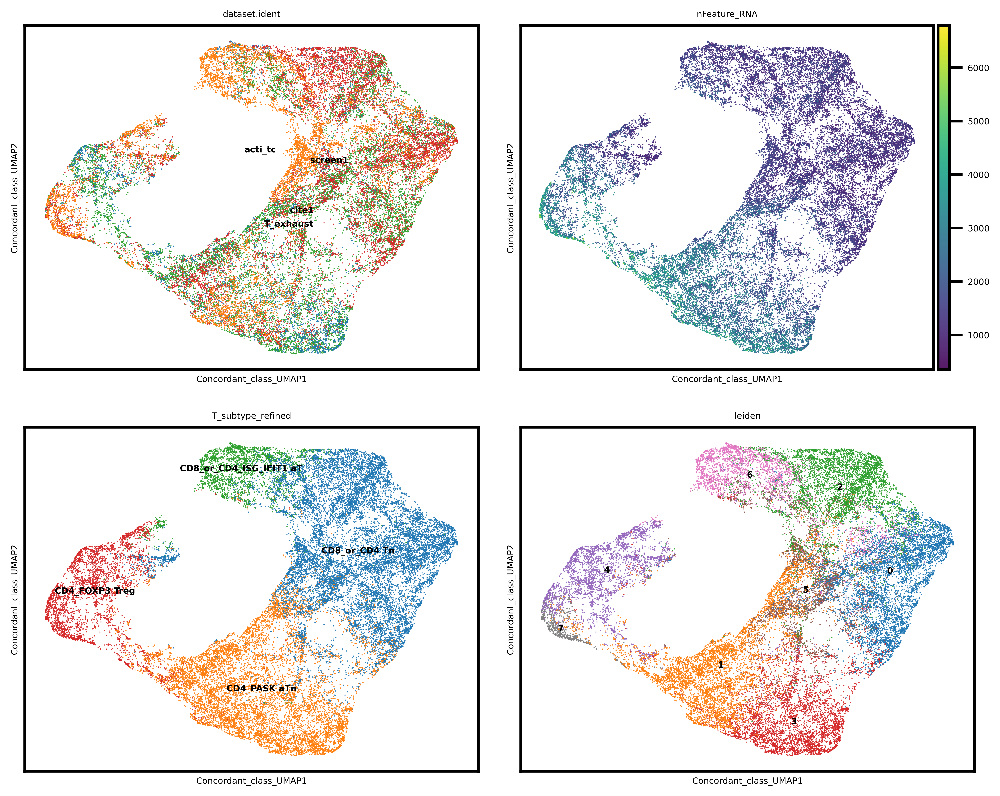

In [21]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)
show_cols = ['dataset.ident', 'nFeature_RNA', 'T_subtype_refined', 'leiden']
show_emb = f'{output_key}_UMAP'

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,8), dpi=600, ncols=2, font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)


### Enhancing with knn contrastive loss

In [52]:
output_key = "Concord-knn"
params['sampler_emb'] = "Concord"
params['device'] = "cpu"
params['use_clr_knn'] = True
params['use_clr_aug'] = True
params['clr_knn_temperature'] = 0.5
params['sampler_knn'] = 32
params['n_epochs'] = 3
cur_ccd = ccd.Concord(adata=adata, **params)
cur_ccd.encode_adata(input_layer_key="X_log1p", output_key=output_key)
obsm_filename = save_dir / f"obsm_{file_suffix}.h5"
ccd.ul.save_obsm_to_hdf5(cur_ccd.adata, obsm_filename)
adata.obsm[output_key] = cur_ccd.adata.obsm[output_key] # If not inplace

Concord - INFO - Column 'dataset.ident' is already of type: category
Concord - INFO - Unused levels dropped for column 'dataset.ident'.
Concord - INFO - Column 'leiden' is already of type: category
Concord - INFO - Unused levels dropped for column 'leiden'.
Concord - INFO - Encoder input dim: 3000
Concord - INFO - Decoder input dim: 40
Concord - INFO - Classifier input dim: 40
Concord - INFO - Total number of parameters: 1563670
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord.model.dataloader - INFO - Using existing embedding 'Concord' from adata.obsm
Concord.model.knn - INFO - Building Faiss IVF index. nprobe=10
Concord.model.datal

Epoch 0 Training: 461it [00:09, 50.66it/s, loss=5.92]

Concord - INFO - Epoch   0 | Train Loss: 6.29, MSE: 0.17, CLASS: 0.93, CLR_AUG: 4.06, CLR_KNN: 1.13, IMPORTANCE: 0.00


Concord - INFO - Epoch:   0 | Train accuracy:  0.66 | precision: 0: 0.73, 1: 0.63, 2: 0.54, 3: 0.78, 4: 0.68, 5: 0.66 | recall: 0: 0.67, 1: 0.76, 2: 0.50, 3: 0.75, 4: 0.77, 5: 0.50 | f1: 0: 0.70, 1: 0.69, 2: 0.52, 3: 0.76, 4: 0.72, 5: 0.57
Concord - INFO - Starting epoch 2/3
Concord - INFO - Processing chunk 1/1 for epoch 2
Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 1 Training: 100%|██████████| 461/461 [00:09<00:00, 46.81it/s, loss=5.49]

Concord - INFO - Epoch   1 | Train Loss: 5.56, MSE: 0.13, CLASS: 0.60, CLR_AUG: 3.84, CLR_KNN: 0.99, IMPORTANCE: 0.00


Concord - INFO - Epoch:   1 | Train accuracy:  0.78 | precision: 0: 0.79, 1: 0.78, 2: 0.71, 3: 0.87, 4: 0.81, 5: 0.77 | recall: 0: 0.83, 1: 0.81, 2: 0.65, 3: 0.87, 4: 0.84, 5: 0.72 | f1: 0: 0.81, 1: 0.79, 2: 0.68, 3: 0.87, 4: 0.83, 5: 0.74
Concord - INFO - Starting epoch 3/3
Concord - INFO - Processing chunk 1/1 for epoch 3
Concord - INFO - Number of samples in train_dataloader: 29584


Epoch 2 Training: 100%|██████████| 461/461 [00:09<00:00, 48.47it/s, loss=4.82]

Concord - INFO - Epoch   2 | Train Loss: 5.30, MSE: 0.13, CLASS: 0.56, CLR_AUG: 3.73, CLR_KNN: 0.89, IMPORTANCE: 0.00


Concord - INFO - Epoch:   2 | Train accuracy:  0.80 | precision: 0: 0.81, 1: 0.80, 2: 0.71, 3: 0.90, 4: 0.81, 5: 0.79 | recall: 0: 0.85, 1: 0.83, 2: 0.66, 3: 0.88, 4: 0.82, 5: 0.75 | f1: 0: 0.83, 1: 0.81, 2: 0.68, 3: 0.89, 4: 0.81, 5: 0.77
Concord - INFO - Model saved to save/dev_concord_treg-Sep01/final_model.pth
Concord - INFO - Final model saved at: save/dev_concord_treg-Sep01/final_model.pth
Concord.model.dataloader - INFO - Preprocessing adata...
Concord.utils.preprocessor - INFO - Normalizing total counts ...
Concord.utils.preprocessor - INFO - Log1p transforming ...
Concord.utils.preprocessor - INFO - Filtering features with provided list (3000 features)...
Concord.model.anndataset - INFO - Initialized dataset with 29584 samples. Data structure: ['input', 'domain', 'class', 'idx']
Concord - INFO - Predicting for chunk 1/1


Concord - INFO - UMAP embedding stored in adata.obsm['Concord-knn_UMAP']


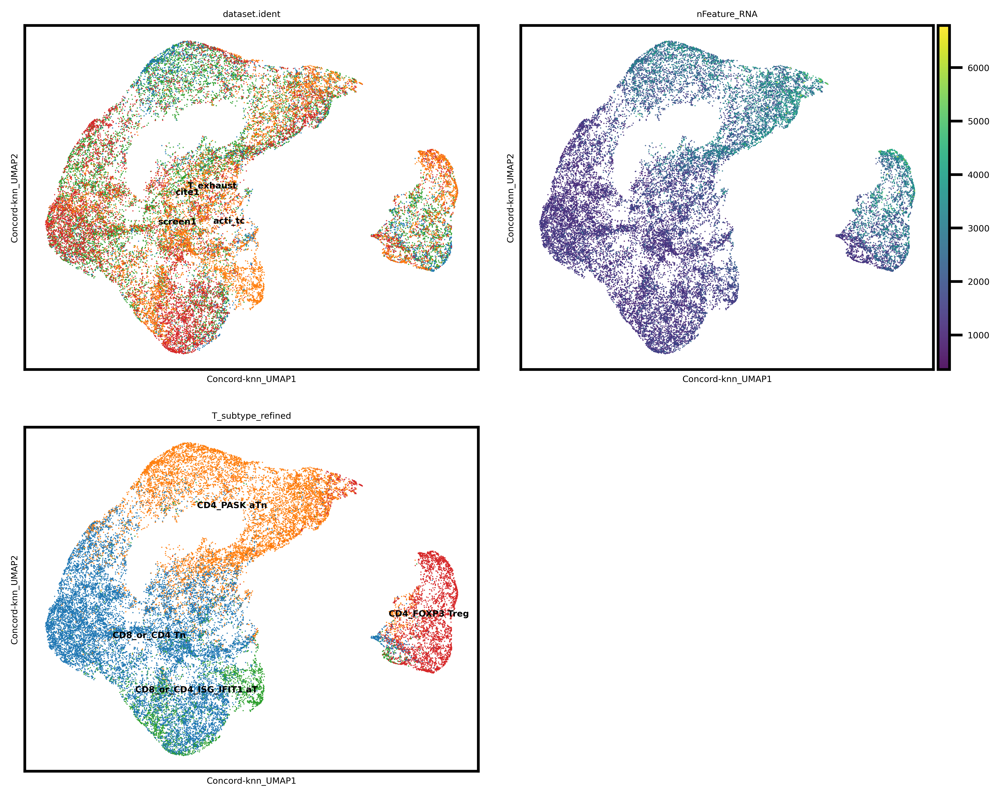

In [54]:
ccd.ul.run_umap(adata, source_key=output_key, umap_key=f'{output_key}_UMAP', n_components=2, n_epochs=500, n_neighbors=15, min_dist=0.1, metric='euclidean', random_state=seed, use_cuml=False)

show_cols = ['dataset.ident', 'nFeature_RNA', 'T_subtype_refined']
adata.obs['T_subtype_refined'] = adata.obs['T_subtype_refined'].cat.remove_unused_categories()
#sc.pp.neighbors(adata, use_rep=f'{output_key}_UMAP')
#sc.tl.leiden(adata, resolution=0.2)
show_emb = f'{output_key}_UMAP'

ccd.pl.plot_embedding(
    adata, show_emb, show_cols, figsize=(10,8), dpi=600, ncols=2, font_size=6, point_size=3, legend_loc='on data',
    save_path=save_dir / f"embeddings_{show_emb}_{file_suffix}.png"
)


loaded 29584 cells and 17 genes


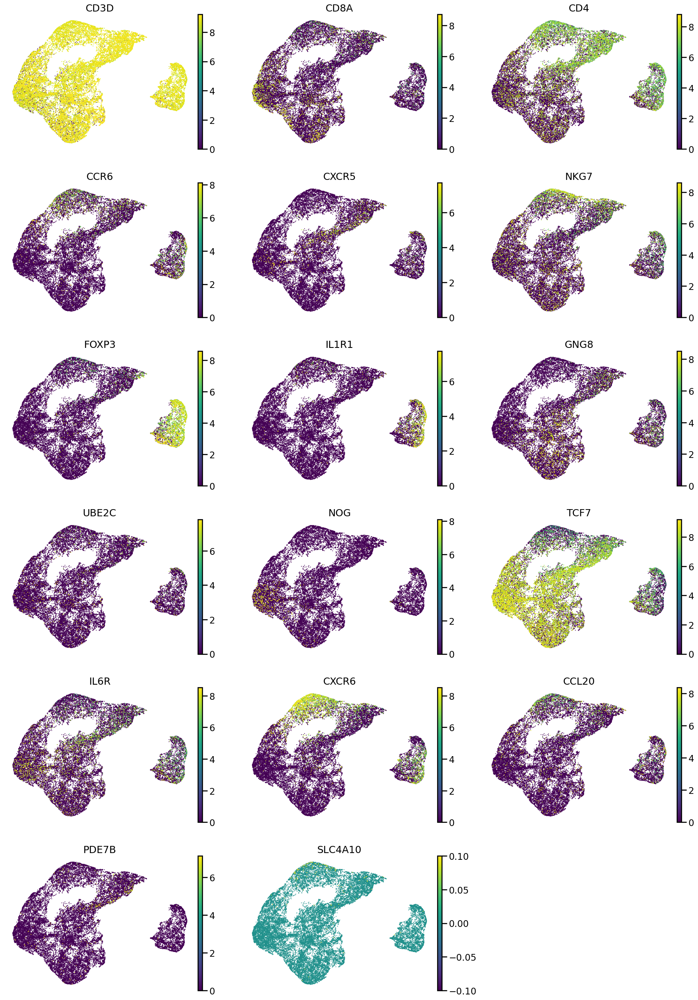

In [55]:
import matplotlib.pyplot as plt
genes_to_load = ["CD3D", "CD8A", "CD4", "CCR6", "CXCR5", "NKG7", "FOXP3", "IL1R1", "GNG8", "UBE2C", 
                 "NOG", "TCF7", "IL6R", "CXCR6","CCL20", "PDE7B", "SLC4A10"]
adata_sub = adata[:, genes_to_load].to_memory()
sc.pp.normalize_total(adata_sub, target_sum=1e4)
sc.pp.log1p(adata_sub)
print(f"loaded {adata_sub.shape[0]} cells and {adata_sub.shape[1]} genes")
# Calculate the 97.5% quantile for each gene
vmax_values = {}
for gene in genes_to_load:
    vmax_values[gene] = np.quantile(adata_sub[:, gene].X.toarray(), 0.995)
show_emb = f'{output_key}_UMAP'
# Plot the gene expression
sc.pl.embedding(
    adata_sub,
    basis=show_emb,
    color=genes_to_load,
    legend_loc='on data',
    frameon=False,
    ncols=3,
    size=8,
    vmax=list(vmax_values.values()),
    cmap='viridis',
    show=False
)
plt.savefig(save_dir / f"gexpr_{show_emb}_{file_suffix}.png", dpi=300, bbox_inches='tight')
plt.show()
plt.close()


In [ ]:
from Concord.utils.visCello import anndata_to_viscello
anndata_to_viscello(adata, save_dir / f"cello_{proj_name}_adata_{file_suffix}", project_name = proj_name, organism='hsa')

R[write to console]: In addition: 
R[write to console]: Warning messages:

R[write to console]: 1: 
R[write to console]: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
R[write to console]: 
 
R[write to console]:  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages

R[write to console]: 2: 
R[write to console]: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
R[write to console]: 
 
R[write to console]:  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages

R[write to console]: 3: 
R[write to console]: In (function (package, help, pos = 2, lib.loc = NULL, character.only = FALSE,  :
R[write to console]: 
 
R[write to console]:  libraries ‘/usr/local/lib/R/site-library’, ‘/usr/lib/R/site-library’ contain no packages



Concord - INFO - Normalized expression data (adata.layers['X_log1p']) not found. Renormalize and log transforming.
VisCello project created at save/dev_concord_treg-Aug26/cello_concord_treg_adata_Aug26-1209
